## Решение хакатона для Утконоса/

In [1]:
import pandas as pd
import glove
import numpy as np
import collections
import gensim.downloader as api
from gensim import corpora, models, similarities
from gensim.corpora import Dictionary
from tqdm import tqdm_notebook
from gensim.models import Word2Vec
import gensim
import math
import logging
import tensorflow as tf
import os
import time
from tensorflow.contrib.tensorboard.plugins import projector

from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt
import numpy as np

from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import pairwise_distances
from scipy.cluster import hierarchy
import matplotlib.pyplot as plt


logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.INFO)

/opt/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
import os
import pandas as pd
import numpy as np
import tensorflow as tf
import gensim
from gensim.models import Word2Vec
import logging
from tensorflow.contrib.tensorboard.plugins import projector

class IterableSentences():
    def __init__(self, sentences):
        self.sentences = sentences
        if '' in self.sentences:
            self.sentences.remove('')

    def __iter__(self):
        return ([str(x) for x in sorted(s)] for s in self.sentences)
        #return (sorted(s.split('.0 ')[:-1]) for s in self.sentences)

def save_vectors_for_tb(model, log_dir):
    words = model.wv.index2word
    #print(words.shape)
    words_data = pd.DataFrame({'word': words, 'names' : result['PRODUCT_NAME'] })
    #'frequency': [model.wv.vocab[w].count for w in words],
    #words_data = pd.DataFrame({'word': result[cols].values, 'names' : result['PRODUCT_NAME'] })
    print(words_data.shape)
    words_data = words_data.dropna()
    print(words_data.shape)
    words_data.to_csv(os.path.join(log_dir, 'metadata.tsv'), sep='\t', index=None)

    tf.reset_default_graph()
    embeddings = tf.Variable(model.wv.vectors, name='embeddings')
    saver = tf.train.Saver()
    config = projector.ProjectorConfig()
    embedding = config.embeddings.add()
    embedding.tensor_name = embeddings.name
    embedding.metadata_path = 'metadata.tsv'
    summary_writer = tf.summary.FileWriter(log_dir)
    projector.visualize_embeddings(summary_writer, config)
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        saver.save(sess, os.path.join(log_dir, "words.ckpt"), 0)

In [ ]:
def most_similar(model,word):
    
# Подгружаем данные с чеками (Каждый чек это строка с id товаров, разделенная запятыми)

data= pd.read_sas('/opt/data/X5_APO/loaylity_cards_receipts_short.sas7bdat')
data['Products'] = data['string'].apply(lambda x: x.decode("utf-8"))

itsent = IterableSentences(list(data['Products']))
model = Word2Vec(itsent, min_count=25, hs = 0, workers = 16, iter = 5)

df = pd.DataFrame(model.wv.vectors)
df['word'] = model.wv.index2word

#Подгружаем справочник товаров

products = pd.read_sas('/opt/data/X5_APO/x5_products.sas7bdat', encoding = 'iso8859_5')
products['word'] = products.PRODUCT_ID
result = pd.merge(df,products[['word','PRODUCT_NAME']],how = 'left', on = 'word').fillna('unknown')

# Сохраняем векторы в tensorbar и на диск
result.to_csv('/opt/OpenSourceProjects/vectors_sas.csv')
save_vectors_for_tb(model, '/opt/OpenSourceProjects/tb_test')

In [142]:
words = model.wv.index2word

In [6]:
items = pd.read_sas('items.sas7bdat')

In [7]:
feedstock_dict = pd.read_sas('feedstock_dict.sas7bdat')

In [8]:
sku_list = pd.read_sas('sku_list.sas7bdat')

In [9]:
orders = pd.read_sas('orders.sas7bdat')

In [192]:
items2.head()

,Сырье/Товар ID,Сырье/Товар Наименование,Группа Закупок,Товарная иерархия (уровень 2) ID,Товарная иерархия (уровень 2) Наименование,Товарная иерархия (уровень 3) ID,Товарная иерархия (уровень 3) Наименование,Признак участия товара в акции SAP,Акция SAP Вид акции,Признак участия товара в акции сайта,Акция сайта Вид акции,Признак отмененного заказа,"Дата создания заказа, дата",Продажи в БЕИ,Выручка с НДС
0,3071950,Конд/белья Lion Воздушный 720,Бытовая химия,004002,Стирка и уход за бельем,004002007,Средства для стирки,0,NaN,NaN,NaN,0,2015-02-06,5,1536
1,3184297,Филе Индолина инд.охл.700г шт,Охлажденное мясо,001019,"Мясо, птица",001019004,Мясо птицы охлажденное и замороженное,0,NaN,NaN,NaN,0,2015-01-31,35,"10345,4"
2,3186437,Яйцо Окское куриное С1 бел.дес,Яйцо,001009,Яйцо,001009005,Яйцо первой категории,1,Регулярное промо,NaN,NaN,0,2015-01-31,383,24129
3,3193219,Бедро Индолина инд.охл.Халяль 700г шт,Охлажденное мясо,001019,"Мясо, птица",001019004,Мясо птицы охлажденное и замороженное,0,NaN,NaN,NaN,0,2015-01-31,30,"8523,9"
4,3154351,Таблетки Claro д/ПММ 2020 25шт,Бытовая химия,004003,Уборка и уход за домом,004003006,Средства для уборки,0,NaN,NaN,NaN,0,2015-01-31,4,"1938,3"


In [10]:
checks = pd.read_sas('checks.sas7bdat')

In [11]:
n = checks['Column8'][0]

In [13]:
cols1 = []
for c1 in checks.columns:
    if c1[:3] == 'Col':
        cols1.append(c1)
def f(X):
    return [x for x in X if np.isnan(x) == False]

In [14]:
words = [f(x) for x in checks[cols1].values.tolist()]

In [16]:
pd.DataFrame(words).to_pickle("checks_generator.pkl")

In [17]:
corp = IterableSentences(words)

In [18]:
model = Word2Vec(corp, min_count=25, hs = 0, workers = 16, iter = 6)

2018-10-11 10:36:42,988 : INFO : collecting all words and their counts
2018-10-11 10:36:42,991 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2018-10-11 10:36:43,059 : INFO : PROGRESS: at sentence #10000, processed 31439 words, keeping 2665 word types
2018-10-11 10:36:43,128 : INFO : PROGRESS: at sentence #20000, processed 64358 words, keeping 3167 word types
2018-10-11 10:36:43,193 : INFO : PROGRESS: at sentence #30000, processed 95523 words, keeping 3392 word types
2018-10-11 10:36:43,263 : INFO : PROGRESS: at sentence #40000, processed 131031 words, keeping 3528 word types
2018-10-11 10:36:43,331 : INFO : PROGRESS: at sentence #50000, processed 165835 words, keeping 3619 word types
2018-10-11 10:36:43,399 : INFO : PROGRESS: at sentence #60000, processed 199210 words, keeping 3683 word types
2018-10-11 10:36:43,468 : INFO : PROGRESS: at sentence #70000, processed 234217 words, keeping 3724 word types
2018-10-11 10:36:43,539 : INFO : PROGRESS: at sentence #

2018-10-11 10:36:47,445 : INFO : PROGRESS: at sentence #730000, processed 2504140 words, keeping 4042 word types
2018-10-11 10:36:47,516 : INFO : PROGRESS: at sentence #740000, processed 2539019 words, keeping 4042 word types
2018-10-11 10:36:47,587 : INFO : PROGRESS: at sentence #750000, processed 2573160 words, keeping 4045 word types
2018-10-11 10:36:47,660 : INFO : PROGRESS: at sentence #760000, processed 2608624 words, keeping 4045 word types
2018-10-11 10:36:47,730 : INFO : PROGRESS: at sentence #770000, processed 2643462 words, keeping 4045 word types
2018-10-11 10:36:47,804 : INFO : PROGRESS: at sentence #780000, processed 2677963 words, keeping 4045 word types
2018-10-11 10:36:47,877 : INFO : PROGRESS: at sentence #790000, processed 2714410 words, keeping 4045 word types
2018-10-11 10:36:47,951 : INFO : PROGRESS: at sentence #800000, processed 2749773 words, keeping 4046 word types
2018-10-11 10:36:48,029 : INFO : PROGRESS: at sentence #810000, processed 2787189 words, keeping

2018-10-11 10:36:52,644 : INFO : PROGRESS: at sentence #1460000, processed 5070598 words, keeping 4058 word types
2018-10-11 10:36:52,716 : INFO : PROGRESS: at sentence #1470000, processed 5106381 words, keeping 4058 word types
2018-10-11 10:36:52,787 : INFO : PROGRESS: at sentence #1480000, processed 5142012 words, keeping 4058 word types
2018-10-11 10:36:52,859 : INFO : PROGRESS: at sentence #1490000, processed 5177667 words, keeping 4058 word types
2018-10-11 10:36:52,930 : INFO : PROGRESS: at sentence #1500000, processed 5212619 words, keeping 4058 word types
2018-10-11 10:36:53,008 : INFO : PROGRESS: at sentence #1510000, processed 5248382 words, keeping 4058 word types
2018-10-11 10:36:53,078 : INFO : PROGRESS: at sentence #1520000, processed 5282538 words, keeping 4058 word types
2018-10-11 10:36:53,126 : INFO : PROGRESS: at sentence #1530000, processed 5315979 words, keeping 4058 word types
2018-10-11 10:36:53,172 : INFO : PROGRESS: at sentence #1540000, processed 5348759 words

2018-10-11 10:36:57,880 : INFO : PROGRESS: at sentence #2180000, processed 7535316 words, keeping 4068 word types
2018-10-11 10:36:57,967 : INFO : PROGRESS: at sentence #2190000, processed 7568565 words, keeping 4068 word types
2018-10-11 10:36:58,053 : INFO : PROGRESS: at sentence #2200000, processed 7601134 words, keeping 4068 word types
2018-10-11 10:36:58,131 : INFO : PROGRESS: at sentence #2210000, processed 7633245 words, keeping 4068 word types
2018-10-11 10:36:58,210 : INFO : PROGRESS: at sentence #2220000, processed 7666328 words, keeping 4068 word types
2018-10-11 10:36:58,284 : INFO : PROGRESS: at sentence #2230000, processed 7698288 words, keeping 4068 word types
2018-10-11 10:36:58,362 : INFO : PROGRESS: at sentence #2240000, processed 7732469 words, keeping 4068 word types
2018-10-11 10:36:58,448 : INFO : PROGRESS: at sentence #2250000, processed 7765968 words, keeping 4068 word types
2018-10-11 10:36:58,535 : INFO : PROGRESS: at sentence #2260000, processed 7798030 words

2018-10-11 10:37:03,516 : INFO : PROGRESS: at sentence #2900000, processed 9922631 words, keeping 4069 word types
2018-10-11 10:37:03,602 : INFO : PROGRESS: at sentence #2910000, processed 9956829 words, keeping 4069 word types
2018-10-11 10:37:03,685 : INFO : PROGRESS: at sentence #2920000, processed 9990973 words, keeping 4069 word types
2018-10-11 10:37:03,771 : INFO : PROGRESS: at sentence #2930000, processed 10024989 words, keeping 4069 word types
2018-10-11 10:37:03,857 : INFO : PROGRESS: at sentence #2940000, processed 10059030 words, keeping 4069 word types
2018-10-11 10:37:03,942 : INFO : PROGRESS: at sentence #2950000, processed 10092120 words, keeping 4069 word types
2018-10-11 10:37:04,028 : INFO : PROGRESS: at sentence #2960000, processed 10127294 words, keeping 4069 word types
2018-10-11 10:37:04,096 : INFO : collected 4075 word types from a corpus of 10156260 raw words and 2967490 sentences
2018-10-11 10:37:04,099 : INFO : Loading a fresh vocabulary
2018-10-11 10:37:04,1

2018-10-11 10:38:09,181 : INFO : EPOCH 2 - PROGRESS: at 23.37% examples, 255230 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:38:14,969 : INFO : EPOCH 2 - PROGRESS: at 25.34% examples, 161651 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:38:15,972 : INFO : EPOCH 2 - PROGRESS: at 28.30% examples, 168954 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:38:17,017 : INFO : EPOCH 2 - PROGRESS: at 31.14% examples, 174289 words/s, in_qsize 1, out_qsize 0
2018-10-11 10:38:18,042 : INFO : EPOCH 2 - PROGRESS: at 33.97% examples, 178672 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:38:19,086 : INFO : EPOCH 2 - PROGRESS: at 36.60% examples, 181408 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:38:20,113 : INFO : EPOCH 2 - PROGRESS: at 39.31% examples, 184477 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:38:21,129 : INFO : EPOCH 2 - PROGRESS: at 41.93% examples, 186864 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:38:22,158 : INFO : EPOCH 2 - PROGRESS: at 44.55% examples, 188918 words/s, in_qsiz

2018-10-11 10:39:41,124 : INFO : EPOCH 3 - PROGRESS: at 88.60% examples, 163914 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:39:42,141 : INFO : EPOCH 3 - PROGRESS: at 91.21% examples, 164887 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:39:43,144 : INFO : EPOCH 3 - PROGRESS: at 93.73% examples, 165856 words/s, in_qsize 1, out_qsize 0
2018-10-11 10:39:49,204 : INFO : EPOCH 3 - PROGRESS: at 95.22% examples, 150202 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:39:50,216 : INFO : EPOCH 3 - PROGRESS: at 98.07% examples, 151914 words/s, in_qsize 0, out_qsize 1
2018-10-11 10:39:50,775 : INFO : worker thread finished; awaiting finish of 15 more threads
2018-10-11 10:39:50,808 : INFO : worker thread finished; awaiting finish of 14 more threads
2018-10-11 10:39:50,809 : INFO : worker thread finished; awaiting finish of 13 more threads
2018-10-11 10:39:50,811 : INFO : worker thread finished; awaiting finish of 12 more threads
2018-10-11 10:39:50,815 : INFO : worker thread finished; awaiting f

2018-10-11 10:40:52,044 : INFO : EPOCH 5 - PROGRESS: at 10.63% examples, 89955 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:40:53,083 : INFO : EPOCH 5 - PROGRESS: at 13.35% examples, 102374 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:40:54,140 : INFO : EPOCH 5 - PROGRESS: at 15.79% examples, 111170 words/s, in_qsize 2, out_qsize 1
2018-10-11 10:40:55,177 : INFO : EPOCH 5 - PROGRESS: at 18.47% examples, 120652 words/s, in_qsize 1, out_qsize 1
2018-10-11 10:40:56,204 : INFO : EPOCH 5 - PROGRESS: at 21.37% examples, 130239 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:40:57,252 : INFO : EPOCH 5 - PROGRESS: at 23.87% examples, 136103 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:40:58,265 : INFO : EPOCH 5 - PROGRESS: at 26.48% examples, 142052 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:40:59,272 : INFO : EPOCH 5 - PROGRESS: at 29.07% examples, 147313 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:41:00,272 : INFO : EPOCH 5 - PROGRESS: at 31.53% examples, 151602 words/s, in_qsize

2018-10-11 10:42:21,748 : INFO : EPOCH 6 - PROGRESS: at 75.15% examples, 170913 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:42:26,766 : INFO : EPOCH 6 - PROGRESS: at 77.30% examples, 155652 words/s, in_qsize 1, out_qsize 0
2018-10-11 10:42:27,792 : INFO : EPOCH 6 - PROGRESS: at 80.26% examples, 157651 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:42:28,798 : INFO : EPOCH 6 - PROGRESS: at 83.11% examples, 159467 words/s, in_qsize 0, out_qsize 1
2018-10-11 10:42:29,819 : INFO : EPOCH 6 - PROGRESS: at 85.94% examples, 161137 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:42:30,860 : INFO : EPOCH 6 - PROGRESS: at 88.60% examples, 162301 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:42:31,915 : INFO : EPOCH 6 - PROGRESS: at 91.30% examples, 163345 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:42:32,915 : INFO : EPOCH 6 - PROGRESS: at 93.84% examples, 164339 words/s, in_qsize 0, out_qsize 0
2018-10-11 10:42:33,930 : INFO : EPOCH 6 - PROGRESS: at 96.49% examples, 165598 words/s, in_qsiz

In [19]:
df = pd.DataFrame(model.wv.vectors)
df['word'] = model.wv.index2word

In [158]:
prod = pd.DataFrame()
prod['word2'] = items2['Сырье/Товар ID'].apply(lambda x: str(x))
df['word2'] = df['word'].apply(lambda x: str(x)[:-2])
prod['PRODUCT_NAME'] = items2['Сырье/Товар Наименование']
prod['group']= items2['Группа Закупок']
prod = prod.drop_duplicates()

In [164]:
result = pd.merge(df, prod[['word2','PRODUCT_NAME','group']], how = 'left', on = 'word2').fillna('unknown')

In [4]:
result = pd.read_csv('word2vec_result.csv')

In [26]:
save_vectors_for_tb(model, '/opt/OpenSourceProjects/tb_test')

(3854, 2)
(3854, 2)


In [30]:
from sklearn.manifold import TSNE

In [31]:
%%time
X_embedded = TSNE(n_components=3, n_iter = 1000).fit_transform(result[cols])

CPU times: user 4min 10s, sys: 33.9 s, total: 4min 44s
Wall time: 4min 45s


In [32]:
X_embedded.shape

(3854, 3)

In [36]:
?hierarchy.linkage

In [7]:
%%time
Z_full = hierarchy.linkage(result[cols],method='ward')

CPU times: user 1.65 s, sys: 100 ms, total: 1.75 s
Wall time: 1.75 s


In [12]:
cl2 = hierarchy.fcluster(Z_full, 12, criterion='distance', R=None, monocrit=None)

In [13]:
len(set(cl2))

358

In [14]:
result['cluster'] = cl2

In [16]:
result[['word2','cluster']].to_csv('clusters.csv',index = False)

In [168]:
result.group.unique()

array(['Яйцо', 'Охлажденное мясо', 'Бытовая химия', 'unknown'],
      dtype=object)

HBox(children=(IntProgress(value=0, max=10), HTML(value='')))

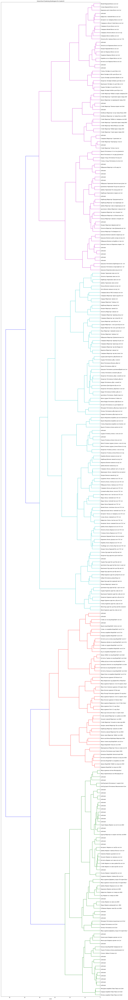

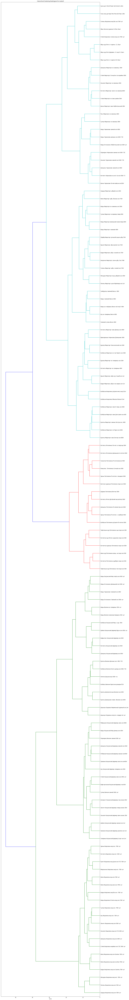

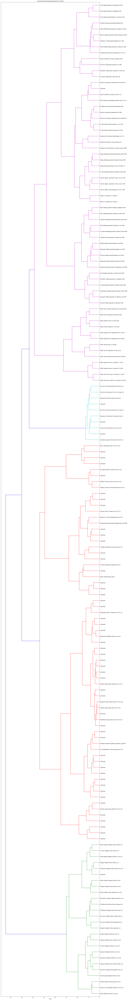

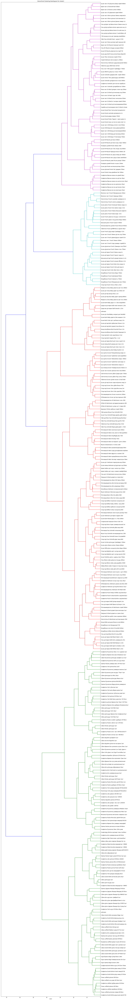

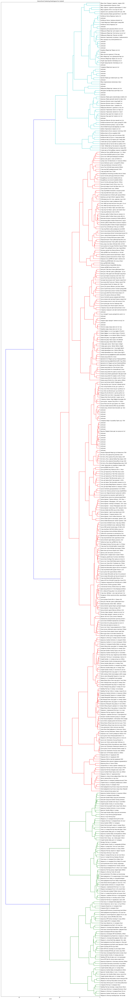

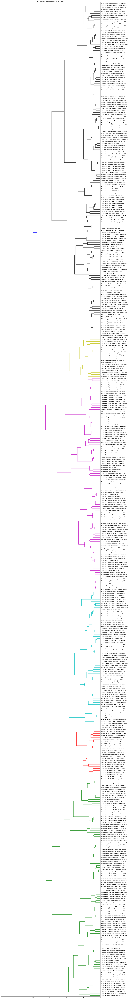

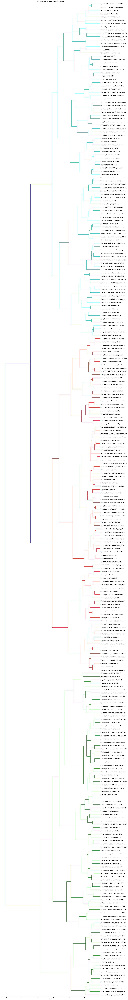

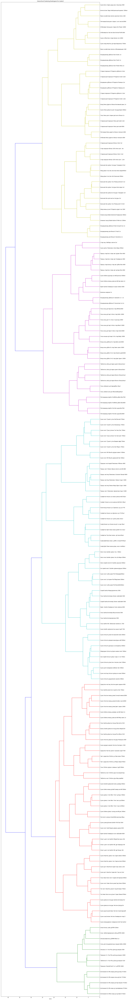

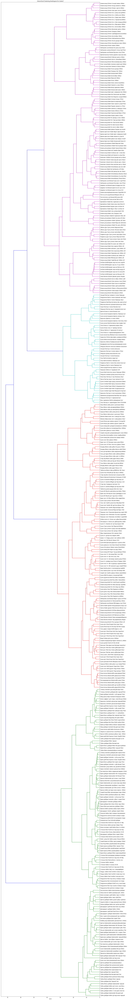

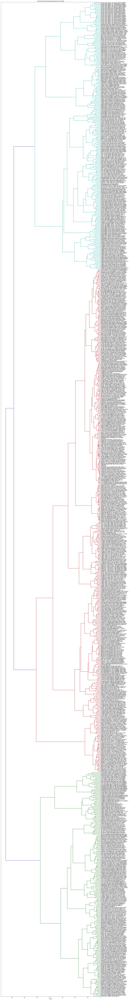

In [190]:
for el in tqdm_notebook(result.cluster.unique()):
    Z = hierarchy.linkage(result[result.cluster == el][cols], 'ward')
    fig=plt.figure(figsize=(20, 200))
    ax = fig.add_axes([0.1,0.1,0.75,0.75])
    ax.set_title("Hierarchical Clustering Dendrogram for cluster" + str(el))
    ax.set_xlabel("distance")
    ax.set_xlabel("name")
    hierarchy.dendrogram(Z, orientation='left',leaf_rotation=0., leaf_font_size=12.,labels=result[result.cluster == el].PRODUCT_NAME.values)
    ax.yaxis.set_label_position('left')
    ax.yaxis.tick_right()
    plt.savefig('tree_for_cluster_'+ str(el) +'.png', dpi=320, format='png', bbox_inches='tight')

HBox(children=(IntProgress(value=0, max=4), HTML(value='')))

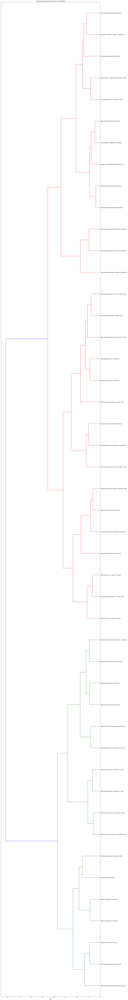

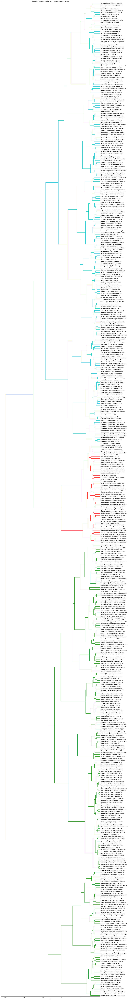

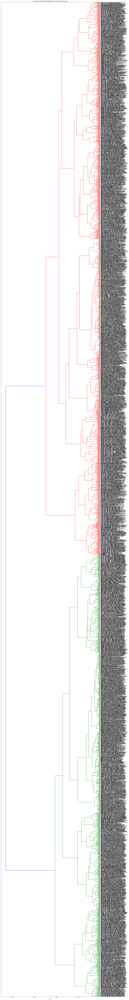

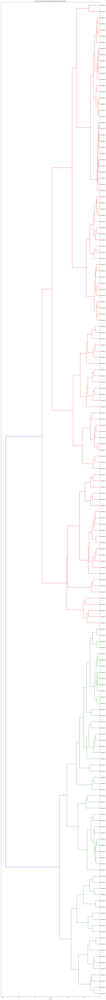

In [170]:
for el in tqdm_notebook(result.group.unique()):
    Z = hierarchy.linkage(result[result.group == el][cols], 'ward')
    fig=plt.figure(figsize=(20, 200))
    ax = fig.add_axes([0.1,0.1,0.75,0.75])
    ax.set_title("Hierarchical Clustering Dendrogram for cluster" + str(el))
    ax.set_xlabel("distance")
    ax.set_xlabel("name")
    hierarchy.dendrogram(Z, orientation='left',leaf_rotation=0., leaf_font_size=12.,labels=result[result.group == el].PRODUCT_NAME.values)
    ax.yaxis.set_label_position('left')
    ax.yaxis.tick_right()
    plt.savefig('tree_for_category_'+ str(el) +'.png', dpi=320, format='png', bbox_inches='tight')

In [59]:
cl = hierarchy.fcluster(Z, 3, criterion='distance', R=None, monocrit=None)

In [102]:
df_cl['cluster2'] = cl2

In [64]:
df_cl['pn'] = result['PRODUCT_NAME']

In [54]:
a = df['word'][2]

In [55]:
model.most_similar(positive=[a])

/opt/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.
/opt/anaconda3/lib/python3.6/site-packages/gensim/matutils.py:737: FutureWarning: Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.
  if np.issubdtype(vec.dtype, np.int):


[('3243285.0', 0.7223095893859863),
 ('3186418.0', 0.6686335802078247),
 ('3303025.0', 0.6514841914176941),
 ('3229152.0', 0.6406714916229248),
 ('3186437.0', 0.6345043182373047),
 ('3051823.0', 0.6101531982421875),
 ('3259484.0', 0.6037434339523315),
 ('3285565.0', 0.5927168130874634),
 ('3319498.0', 0.5662137866020203),
 ('3286410.0', 0.5654202699661255)]

In [ ]:
def most_similar_word(word):
    print(prod[products.PROD_ID == word]['PRODUCT_NAME'])
    print('******************************************************')
    print(pd.merge(pd.DataFrame(model_w2v_v2.wv.most_similar(positive=[word]), columns =['word','probability']),
                    products, how ='inner', on ='word')[['word','probability','PRODUCT_NAME']])

In [137]:
clustres_dbscan = DBSCAN(eps = 1, min_samples=2).fit_predict(X_embedded)

In [139]:
len(set(clustres_dbscan))

750

In [197]:
df_cl['cluster_d'] = clustres_dbscan

In [210]:
result['cluster_dbscan'] = clustres_dbscan

In [202]:
df_cl['SKU_ID'] = prod.word2

In [211]:
result.to_csv('clusters.csv')

In [212]:
items2

,Сырье/Товар ID,Сырье/Товар Наименование,Группа Закупок,Товарная иерархия (уровень 2) ID,Товарная иерархия (уровень 2) Наименование,Товарная иерархия (уровень 3) ID,Товарная иерархия (уровень 3) Наименование,Признак участия товара в акции SAP,Акция SAP Вид акции,Признак участия товара в акции сайта,Акция сайта Вид акции,Признак отмененного заказа,"Дата создания заказа, дата",Продажи в БЕИ,Выручка с НДС
0,3071950,Конд/белья Lion Воздушный 720,Бытовая химия,004002,Стирка и уход за бельем,004002007,Средства для стирки,0,NaN,NaN,NaN,0,2015-02-06,5,1536
1,3184297,Филе Индолина инд.охл.700г шт,Охлажденное мясо,001019,"Мясо, птица",001019004,Мясо птицы охлажденное и замороженное,0,NaN,NaN,NaN,0,2015-01-31,35,"10345,4"
2,3186437,Яйцо Окское куриное С1 бел.дес,Яйцо,001009,Яйцо,001009005,Яйцо первой категории,1,Регулярное промо,NaN,NaN,0,2015-01-31,383,24129
3,3193219,Бедро Индолина инд.охл.Халяль 700г шт,Охлажденное мясо,001019,"Мясо, птица",001019004,Мясо птицы охлажденное и замороженное,0,NaN,NaN,NaN,0,2015-01-31,30,"8523,9"
4,3154351,Таблетки Claro д/ПММ 2020 25шт,Бытовая химия,004003,Уборка и уход за домом,004003006,Средства для уборки,0,NaN,NaN,NaN,0,2015-01-31,4,"1938,3"
5,3185186,Сердце Индолина инд.охл.700г шт,Охлажденное мясо,001019,"Мясо, птица",001019006,Субпродукты охлажденные и замороженные,0,NaN,NaN,NaN,0,2015-01-31,12,3304
6,3197313,Смягчитель Ecover д/бел.Среди цвет.750мл,Бытовая химия,004002,Стирка и уход за бельем,004002007,Средства для стирки,0,NaN,NaN,NaN,0,2015-01-31,1,303
7,3203662,Яйцо Окское куриное С2 бел.10шт,Яйцо,001009,Яйцо,001009001,Яйцо второй категории,0,NaN,NaN,NaN,0,2015-01-14,179,"9548,7"
8,3152387,Салфетка Русалочка Люкс Ultra унив.,Бытовая химия,#,Не присвоено,#,Не присвоено,0,NaN,NaN,NaN,0,2015-01-14,22,"1195,67"
9,3184317,Котлета Индолина инд.охл. 500г шт,Охлажденное мясо,001019,"Мясо, птица",001019002,Полуфабрикаты охлажденные и замороженные,0,NaN,NaN,NaN,0,2015-01-31,22,"4664,7"


In [228]:
c1 = result.columns[-5:]

In [230]:
result[result.cluster_dbscan ==47][c1]

,word2,PRODUCT_NAME,group,cluster,cluster_dbscan
121,3262760,Салфетки House Lux сухие унив.125шт,Бытовая химия,3,47
177,3262759,Салфет.House Lux вл.унив.антиб.6in1 80шт,Бытовая химия,3,47
566,3262771,Салфетки House Lux Дуопак сух.2*125шт,Бытовая химия,3,47
653,3262772,Полотенца House Lux Триопак cух.ун.3*70,Бытовая химия,3,47
909,3262757,Салфетки House Lux влаж.унив.антиб.30шт,Бытовая химия,3,47


In [217]:
df_cl[df_cl.cluster2 ==342]

,0,1,2,cluster,pn,cluster2,cluster_d,SKU_ID
733,-19.822840,10.158044,3.970673,8,Губка д/обуви Salamander бесцветный,342,-1,3148393
894,-20.432159,11.832573,4.437533,5,Губка д/обуви Salton д/гл.кож.с доз.бесц,342,264,3053785
1013,-17.744825,9.592146,5.464884,15,Губка д/обуви Salton 3 слоя д/вл.очистки,342,-1,NaN
1022,-20.593868,10.712792,3.647078,8,Губка-блеск д/обуви Salamander черный,342,-1,NaN
1123,-19.654230,12.495195,4.869246,5,Губка д/обуви Salton д/гл.кож.с доз.чер,342,-1,NaN


In [201]:
prod

,word2,PRODUCT_NAME,group
0,3071950,Конд/белья Lion Воздушный 720,Бытовая химия
1,3184297,Филе Индолина инд.охл.700г шт,Охлажденное мясо
2,3186437,Яйцо Окское куриное С1 бел.дес,Яйцо
3,3193219,Бедро Индолина инд.охл.Халяль 700г шт,Охлажденное мясо
4,3154351,Таблетки Claro д/ПММ 2020 25шт,Бытовая химия
5,3185186,Сердце Индолина инд.охл.700г шт,Охлажденное мясо
6,3197313,Смягчитель Ecover д/бел.Среди цвет.750мл,Бытовая химия
7,3203662,Яйцо Окское куриное С2 бел.10шт,Яйцо
8,3152387,Салфетка Русалочка Люкс Ultra унив.,Бытовая химия
9,3184317,Котлета Индолина инд.охл. 500г шт,Охлажденное мясо


In [198]:
len([x for x in clustres_dbscan if x == -1 ])

281

In [145]:
Z

array([[5.12000000e+02, 7.56000000e+02, 7.05268594e-04, 2.00000000e+00],
       [6.35000000e+02, 8.51000000e+02, 1.37585659e-03, 2.00000000e+00],
       [3.67000000e+02, 6.78000000e+02, 2.49996627e-03, 2.00000000e+00],
       ...,
       [7.69900000e+03, 7.70200000e+03, 5.14049897e+02, 1.66100000e+03],
       [7.70100000e+03, 7.70300000e+03, 6.24575859e+02, 2.19300000e+03],
       [7.70400000e+03, 7.70500000e+03, 8.56174834e+02, 3.85400000e+03]])

In [151]:
df_cl[df_cl.cluster_d == 6]

,0,1,2,cluster,pn,cluster2,cluster_d
12,16.556236,-1.632167,18.465801,221,Губка д/посуды York Maxi 5шт,96,6
148,16.249239,-1.361184,18.814407,221,Губка д/посуды York 10шт,96,6
184,16.292416,-0.804417,19.567659,221,Салфетка York губчатая 3шт,98,6
185,16.139101,-1.345704,18.467438,221,Губки д/посуды Фрекен Бок Симфония 6шт,96,6
450,16.141598,-0.988823,19.002470,221,Губка д/посуды York Midi 10шт,96,6
